# Project Description

In this project, we'll be extracting instrument tracks from a whole mix of music.

# Random

In [1]:
import pandas as pd
import numpy as np
import librosa
import soundfile as sf


%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
import IPython.display as ipd
import crepe
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')


In [2]:
!pip install crepe

##### Import audio with Librosa

In [3]:
audiofile, sr = librosa.load('mix.mp3')

In [4]:
audiofile

array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)

In [5]:
sr

22050

In [6]:
df = pd.DataFrame(audiofile)

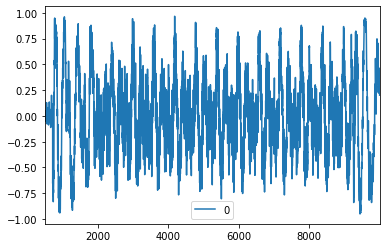

In [7]:
df[500:10000].plot()

##### Estimate tempo

In [8]:
librosa.beat.tempo(y=audiofile, sr=sr)

array([151.99908088])

##### Plot waveform

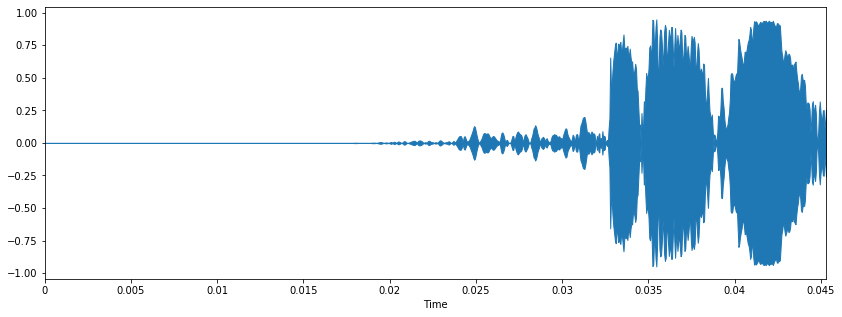

In [9]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(audiofile[:1000], sr=sr)

##### Display spectrogram

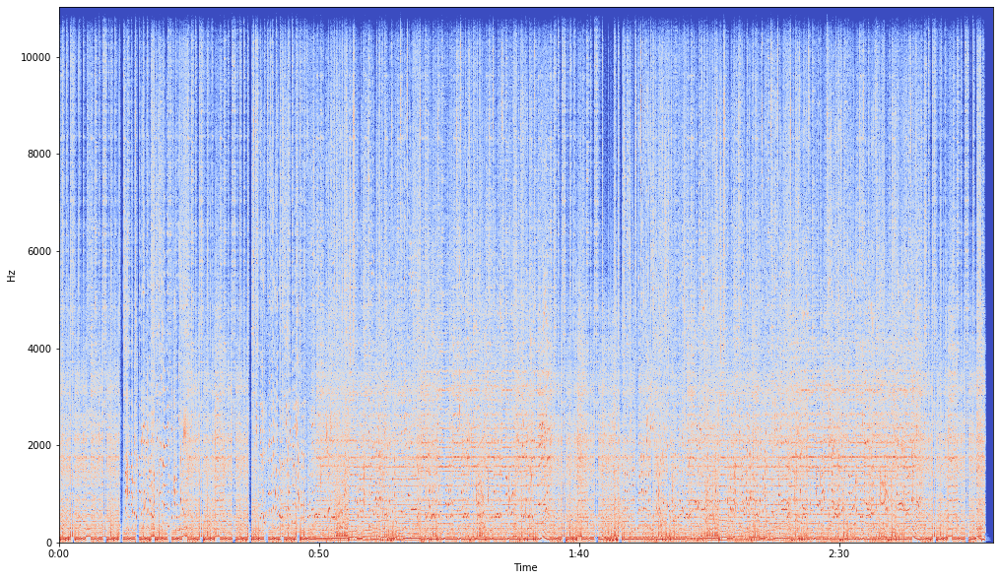

In [10]:
X = librosa.stft(audiofile)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(17, 10))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')

In [11]:
Xdb.shape

(1025, 7737)

##### Play Audio File

In [12]:
play = lambda x: ipd.Audio(x)

In [13]:
play('mix.mp3')

In [14]:
play('10_ElecGtr01.mp3')

##### Save Audio File

In [15]:
#librosa.output.write_wav('audio/audiofile.wav', audiofile, sr)


##### Espectrogram Component Decomposition 

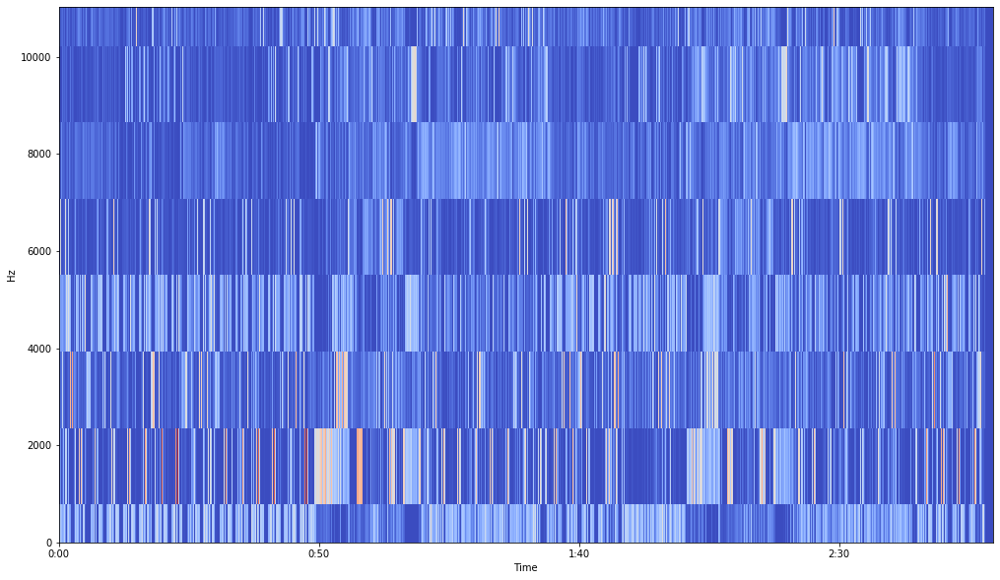

In [16]:
# y, sr = librosa.load(librosa.util.example_audio_file())
S = np.abs(librosa.stft(audiofile))
comps, acts = librosa.decompose.decompose(S, n_components=8)


plt.figure(figsize=(17,10))
librosa.display.specshow(acts, sr=sr, x_axis='time', y_axis='hz', cmap='coolwarm')

In [17]:
ipd.Audio(data=acts[0], rate=sr, normalize=True)

##### Sine wave

In [ ]:
# Get x values of the sine wave
time= np.arange(0, 10, 0.1);

# Amplitude of the sine wave is sine of a variable like time
amplitude= np.sin(time)

# Plot a sine wave using time and amplitude obtained for the sine wave
plt.plot(time, amplitude)

# Give a title for the sine wave plot
plt.title('Sine wave')

# Give x axis label for the sine wave plot
plt.xlabel('Time')

# Give y axis label for the sine wave plot
plt.ylabel('Amplitude = sin(time)')

plt.grid(True, which='both')

plt.axhline(y=0, color='k')

plt.show()

##### Pitch recognition with crepe

In [ ]:
# sr, audio = wavfile.read('mix.mp3')
time, frequency, confidence, activation = crepe.predict(audiofile, sr, viterbi=True)

In [ ]:
time

In [ ]:
frequency

In [ ]:
confidence

In [ ]:
activation

# Import

## Data

We'll be getting some rock songs to train our model with. This songs must have the most representative sample of the genre, in order to be able to generalize with them. 

Then, we'll also get the guitar tracks of each one of them to compare them with the mix song and train our model to recognize the features that correspond to the instrument in each track.

Later on, we'll get all the samples we can gather to train our model in the different styles of sound that can fit into the guitar personality.

In [ ]:
# data, samplerate = sf.read(filename, dtype='float32')
# data = data.T

# # the signal is not resampled to 22050 Hz by default, hence it would need be transposed and resampled for further processing in librosa

# data_22k = librosa.resample(data, samplerate, 22050)


We'll import both full mix and single guitar track on librosa in order to get a numpy array containing the values on each sample (smallest unit of information on an audio track)

In [19]:
mix, sr = librosa.load('data/aceofspades/mix.mp3')

gtr, sr = librosa.load('data/aceofspades/Guitar.mp3')

sr

22050

We can hear the import using IPython display. The 'rate' argument defines the sample rate of the audio file. In this case, librosa imports audio tracks at 22KHz by default, as seen on the previous print:

In [20]:
ipd.Audio(mix, rate=sr)

In [110]:
ipd.Audio(gtr, rate=sr)

Observing waveform to find anomalies on import

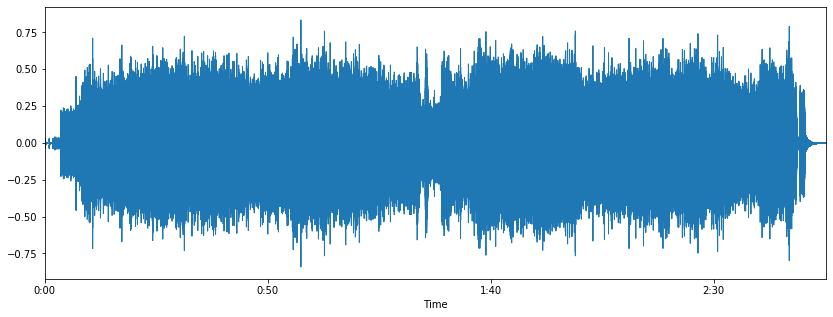

In [21]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(mix, sr=sr)
plt.show()

# EDA

After we gather the files, we'll proceed to examine them in order to find possible irregularities and watch for the loudness of the signals, to see if we have to process them in a way or another.

Also, we'll trim the signals in different lenghts and sections to potentially improve our predictions.

With this signals, we'll build a DataFrame to train our model with.

In [22]:
# Building DataFrame:

df = pd.DataFrame({'mix': mix, 'gtr': gtr}, columns=['mix', 'gtr'])


In [23]:
df.shape

(3862656, 2)

In [102]:
df.head()

,mix,gtr
0,-0.000066,0.0
1,0.000051,0.0
2,-0.000025,0.0
3,-0.000055,0.0
4,0.000131,0.0


# Transformation

In [79]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import Normalizer

MinMaxScaler(), Normalizer(), StandardScaler()

In [137]:
def window_stack(a, stepsize=1, width=3):
    return np.hstack( a[i:1+i-width or None:stepsize] for i in range(0,width) )

In [138]:
X = window_stack(df.mix)

In [24]:
from sklearn.model_selection import train_test_split

In [39]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=None)

# Modeling

## Logistic Regression

## KNN

## Random Forest Classifier

# Prepare data for CNN

In order to properly train our deep learning model, we'll have to transform the data in various ways.

  - The convolutional network needs the data to be grouped on windows of samples. 

In [177]:
test = mix

In [185]:
test.shape

WINDOWS_SIZE = 5
STRIDE = 1
indexer = np.arange(WINDOWS_SIZE)[None, :] + STRIDE*np.arange(len(test) + STRIDE - WINDOWS_SIZE)[:, None]

In [232]:
indexer.shape

(3862652, 5)

In [237]:
y = gtr[:-WINDOWS_SIZE+1]

In [187]:
## need to add other dim?

#index3d = np.expand_dims(indexer, 1)

## 1D Convolutional Neural Network

In [206]:
mix.shape

(3862656,)

In [207]:
gtr.shape

(3862656,)

In [212]:
indexer.shape

(3862652, 5)

In [218]:
WINDOWS_SIZE

5

https://blog.goodaudience.com/introduction-to-1d-convolutional-neural-networks-in-keras-for-time-sequences-3a7ff801a2cf

![1DConv]('file:///Users/Sosa/Desktop/1DConv.png')

In [58]:
from keras.models import Sequential
from keras.layers import Dense, Conv1D, Flatten, Dropout, MaxPooling1D

In [ ]:
# input_shape(batch, time_step, ndim)

In [242]:
def create_model():
    
    model = Sequential()
    model.add(Conv1D(64, 
#                      strides=5, 
                     kernel_size=3, activation='relu', input_shape=(4, WINDOWS_SIZE, 1), name='input_layer'))
    model.add(Conv1D(32, kernel_size=3, activation='relu', name='conv32_layer'))
#     model.add(MaxPooling1D())
#     model.add(Dropout(0.5))
    model.add(Flatten())
    model.add(Dense(100, activation='relu'))
    model.add(Dense(1, activation='relu')) 
    
    model.compile(
        optimizer='adam',
        loss='sparse_categorical_crossentropy',
    metrics=['accuracy'],
    )
    
    return model

model1D = create_model()

# n_epoch = 12
# model.fit(x=train.repeat(n_epoch))
# model.evaluate(test)

ValueError: Input 0 is incompatible with layer input_layer: expected ndim=3, found ndim=4

In [239]:
indexer.shape

(3862652, 5)

In [240]:
model1d.fit(indexer, y)

ValueError: Error when checking input: expected input_layer_input to have 3 dimensions, but got array with shape (3862652, 5)

In [169]:
model = Sequential()
model.add(Conv1D(64, kernel_size=2, activation='relu', input_shape=(WINDOWS_SIZE, 1), name='input_layer'))
#     model.add(Conv1D(32, kernel_size=3, activation='relu'))
#     model.add(Dropout(0.5))(input_model)
#     model.add(Flatten())
#     model.add(Dense(100, activation='relu'))
#     model.add(Dense(10, activation='relu')) 
    
model.compile(
        optimizer='adam',
        loss='sparse_categorical_crossentropy',
        metrics=['accuracy'],
        )
    

In [220]:
model.summary()

Model: "sequential_61"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_layer (Conv1D)         (None, 3, 64)             256       
_________________________________________________________________
conv32_layer (Conv1D)        (None, 1, 32)             6176      
_________________________________________________________________
flatten_9 (Flatten)          (None, 32)                0         
_________________________________________________________________
dense_15 (Dense)             (None, 100)               3300      
_________________________________________________________________
dense_16 (Dense)             (None, 1)                 101       
Total params: 9,833
Trainable params: 9,833
Non-trainable params: 0
_________________________________________________________________


In [170]:
model.fit(indexer)

ValueError: Error when checking input: expected input_layer_input to have 3 dimensions, but got array with shape (3862647, 10)

In [100]:
# Second type of Conv1D network

def Dropout_1D():
    model = Sequential()
    
    model.add(Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(X.shape[0], 1))
    model.add(Conv1D(filters=64, kernel_size=3, activation='relu'))
    
    model.add(Dropout(0.5))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Flatten())
    model.add(Dense(100, activation='relu'))
    model.add(Dense(1, activation='tanh'))
    
    model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

    return model

Dropout = Dropout_1D()

SyntaxError: invalid syntax (<ipython-input-100-569b27c5c3b9>, line 7)

# Alternatives

### Log-Mel spectrogram

One more advanced approach to audio classification is using Mel-spectrogram instead of raw audio wave.
Mel spectrogram “is a representation of the short-term power spectrum of a sound, based on a linear cosine transform of a log power spectrum on a nonlinear mel scale of frequency.” — https://en.wikipedia.org/wiki/Mel-frequency_cepstrum

Mel spectrogram transform the input raw sequence to a 2D feature map where one dimension represents time and the other one represents frequency and the values represents amplitude.


source = https://github.com/cvxtz/audio_classification

The Mel Spectrogram is the result of the following pipeline:

    - Separate to windows: Sample the input with windows of size n_fft=2048, making hops of size hop_length=512 each time to sample the next window.
    - Compute FFT (Fast Fourier Transform) for each window to transform from time domain to frequency domain.
    - Generate a Mel scale: Take the entire frequency spectrum, and separate it into n_mels=128 evenly spaced frequencies. And what do we mean by evenly spaced? not by distance on the frequency dimension, but distance as it is heard by the human ear.
    - Generate Spectrogram: For each window, decompose the magnitude of the signal into its components, corresponding to the frequencies in the mel scale.
    
Implementation paper: https://www.researchgate.net/profile/Alexander_Schindler/publication/313895558_Parallel_Convolutional_Neural_Networks_for_Music_Genre_and_Mood_Classification/links/58aead3645851503be9203b8/Parallel-Convolutional-Neural-Networks-for-Music-Genre-and-Mood-Classification.pdf



https://medium.com/@nadimkawwa/can-we-guess-musical-instruments-with-machine-learning-afc8790590b8


In [199]:
def preprocess_audio_mel_T(audio, sample_rate=16000, window_size=20, #log_specgram
                           step_size=10, eps=1e-10):

    mel_spec = librosa.feature.melspectrogram(y=audio, sr=sample_rate, n_mels= n_mels)
    mel_db = (librosa.power_to_db(mel_spec, ref=np.max) + 40)/40

    return mel_db.T

# y, sr = librosa.core.load(file)


# librosa.feature.melspectrogram(y=None, sr=22050, S=None, n_fft=2048, 
#                                hop_length=512, win_length=None, window='hann', 
#                                center=True, pad_mode='reflect', power=2.0, **kwargs)



In [201]:
mel = preprocess_audio_mel_T(mix)

##### Inverse melspectrogram conversion

In [ ]:
librosa.feature.inverse.mel_to_audio(M, sr=22050, n_fft=2048, hop_length=512, win_length=None, window='hann', 
                                     center=True, pad_mode='reflect', 
                                     power=2.0, n_iter=32, length=None, dtype=<class 'numpy.float32'>, **kwargs)

### 2DConv Network

In [197]:
from keras.layers import Conv2D

In [194]:
# Initializing a random seed for replication purposes
np.random.seed(23456)

# Initiating an empty neural network
model = Sequential()

# Adding a flattened layer to input our image data
model.add(Flatten(input_shape = (128, 660, 1)))

# Adding a dense layer with 128 neurons
model.add(Dense(128, activation='relu'))

# Adding a dense layer with 128 neurons
model.add(Dense(128, activation='relu'))

# Adding a dense layer with 64 neurons
model.add(Dense(64, activation='relu'))

# Adding an output layer
model.add(Dense(10, activation='tanh'))

# Compiling our neural network
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

In [203]:
mel.shape

(7545, 128)

### FastICA

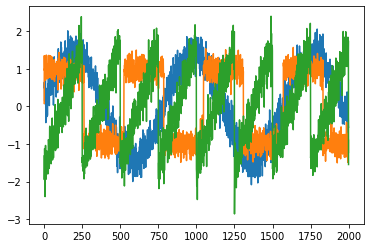

In [89]:
plt.plot(S)

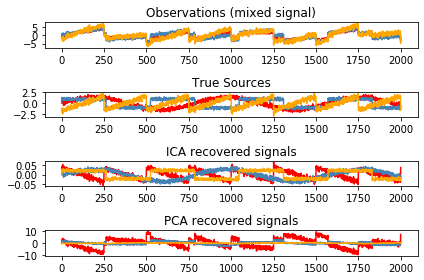

In [84]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal

from sklearn.decomposition import FastICA, PCA

# #############################################################################
# Generate sample data
np.random.seed(0)
n_samples = 2000
time = np.linspace(0, 8, n_samples)

s1 = np.sin(2 * time)  # Signal 1 : sinusoidal signal
s2 = np.sign(np.sin(3 * time))  # Signal 2 : square signal
s3 = signal.sawtooth(2 * np.pi * time)  # Signal 3: saw tooth signal

S = np.c_[s1, s2, s3]
S += 0.2 * np.random.normal(size=S.shape)  # Add noise

S /= S.std(axis=0)  # Standardize data
# Mix data
A = np.array([[1, 1, 1], [0.5, 2, 1.0], [1.5, 1.0, 2.0]])  # Mixing matrix
X = np.dot(S, A.T)  # Generate observations

# X = mix

# Compute ICA
ica = FastICA(n_components=4)
S_ = ica.fit_transform(X)  # Reconstruct signals
A_ = ica.mixing_  # Get estimated mixing matrix

# We can `prove` that the ICA model applies by reverting the unmixing.
assert np.allclose(X, np.dot(S_, A_.T) + ica.mean_)

# For comparison, compute PCA
pca = PCA(n_components=3)
H = pca.fit_transform(X)  # Reconstruct signals based on orthogonal components

# #############################################################################
# Plot results

plt.figure()

models = [X, S, S_, H]
names = ['Observations (mixed signal)',
         'True Sources',
         'ICA recovered signals',
         'PCA recovered signals']
colors = ['red', 'steelblue', 'orange']

for ii, (model, name) in enumerate(zip(models, names), 1):
    plt.subplot(4, 1, ii)
    plt.title(name)
    for sig, color in zip(model.T, colors):
        plt.plot(sig, color=color)

plt.tight_layout()
plt.show()

In [122]:
ipd.Audio(S, rate= sr)

# INFO

We use 30-60s preview clips which are provided after
trimming to represent the highlight of the song. We trim audio
signals to 29 seconds at the centre of preview clips and downsample them from 22.05 kHz to 12 kHz using Librosa [19].
Log-amplitude mel-spectrograms are used as input since they
have outperformed STFT and MFCCs, and linear-amplitude
mel-spectrograms in earlier research [2, 1]. The number of
mel-bins is 96 and the hop-size is 256 samples, resulting in
an input shape of 96×1366.



# Training

In [171]:
def load_dataset(prefix=''):
	# load all train
	trainX, trainy = load_dataset_group('train', prefix + 'HARDataset/')
	print(trainX.shape, trainy.shape)
	# load all test
	testX, testy = load_dataset_group('test', prefix + 'HARDataset/')
	print(testX.shape, testy.shape)
	# zero-offset class values
	trainy = trainy - 1
	testy = testy - 1
	# one hot encode y
	trainy = to_categorical(trainy)
	testy = to_categorical(testy)
	print(trainX.shape, trainy.shape, testX.shape, testy.shape)
	return trainX, trainy, testX, testy

In [172]:
df = load_dataset()

NameError: name 'load_dataset_group' is not defined